In [4]:
%matplotlib inline

# BrainHack Marseille 2023: "Surf(ac)ing fMRI" Project 
# -- Comparison between volume-based and surface-based GLM --
 ### Data from BRAINT project, task-03ArchiLocalizer. 
 ### Data anonymized by [bidsonym](https://peerherholz.github.io/BIDSonym) and preprocessed with [fmriprep](https://fmriprep.org/en/stable/) in volume and surface.
 ***

### Read the behavioural text file and build the DataFrame: "events" 

In [5]:
from IPython.display import display, HTML
import numpy as np
import pandas as pd
import chardet as cd


# path to sourcedata file

init_dir='/Users/jsein/Documents/Centre_IRMf/DATA/BIDS/BRAINT'
event_path=init_dir+'/sourcedata/sub-011/ses-02/sub-011_ses-02_task-03ArchiLocalizer_23_05_23_15_22.txt'
event_input = pd.read_csv(event_path,sep= '\t' , encoding='mac_roman')


In [6]:
# to determine the encoding, which is not standard here

with open(event_path, 'rb') as f:
    result = cd.detect(f.read())  # or readline if the file is large
    
print(result)


{'encoding': 'ISO-8859-1', 'confidence': 0.73, 'language': ''}


In [7]:
df_orig = pd.read_csv(event_path, encoding=result['encoding'], delimiter='\t')

print(df_orig)

     CONDITIONS  DURATIONS STIM_TEXT STIM_BITMAP STIM_WAV  RESPONSE_BUTTON  \
0             0         52       NaN        Noir      NaN                0   
1             8         27       NaN        Noir    calc1                0   
2             0          6       NaN        Noir      NaN                0   
3             8         27       NaN        Noir    calc2                0   
4             0         18       NaN        Noir      NaN                0   
..          ...        ...       ...         ...      ...              ...   
484           5         18       NaN        Noir      NaN                4   
485          10         27       NaN        Noir      ph9                0   
486           0         21       NaN        Noir      NaN                0   
487          10         27       NaN        Noir     ph10                0   
488           0         83       NaN        Noir      NaN                0   

     ONSETS_TRIGGERS  ONSETS_MS  REPONSE_1  JUSTE  INSTANT_REPO

In [8]:
# DataFrame for events: condition, onset, duration; time in seconds for nilearn
df_ev = pd.DataFrame()

# previous condition to check blocks
prev_cond = ''
# initialize duration and onset (in seconds)
duration = -1.0
onset = -1.0
onset2 = -1.0

# iterate over rows348156
for l in df_orig[['CONDITIONS', 'ONSETS_MS', 'ONSETS_TRIGGERS', 'DURATIONS']].iterrows():
    # get values
    _, (cur_cond, cur_ons2, cur_ons, cur_dur) = l
    # check if equality between current and past values for condition
    if cur_cond==prev_cond:
        duration += cur_dur
    else:
        # add row to DataFrame (conversion of onset and duration from trigger to seconds, 1 trigger = 80 ms; conversion of onset 2 from ms to s)
#        print(cur_cond, onset, duration)
        if not prev_cond=='':
            df_tmp = pd.DataFrame({'condition': prev_cond, 'onset2': onset2 / 1000.0, 'onset': onset * 0.08, 'duration': duration * 0.08}, [0])
            df_ev = pd.concat((df_ev, df_tmp), ignore_index=True)
        # move to next block
        prev_cond = cur_cond
        onset2 = cur_ons2
        onset = cur_ons
        duration = cur_dur
        
# check if onsets are similar in ms and trigger
df_ev

,condition,onset2,onset,duration
0,0,0.000,0.00,4.16
1,8,4.160,4.16,2.16
2,0,6.320,6.32,0.48
3,8,6.799,6.80,2.16
4,0,8.960,8.96,3.60
...,...,...,...,...
153,0,338.076,338.08,1.36
154,5,339.436,339.44,2.72
155,10,342.156,342.16,2.16
156,0,344.316,344.32,1.68


In [9]:
# check all conditions
print(np.unique(df_ev['condition']))

[ 0  1  2  3  4  5  6  7  8  9 10]


In [10]:
condition_ids = [
    "rest",      #"rest" will be condition 0
    "vertical checkerboard",     #"vertical checkerboard" will be condition 1
    "horizontal checkerboard",   # ...
    "left button press, visual instructions",
    "left button press, auditory instructions",
    "right button press, visual instructions",
    "right button press, auditory instructions",
    "mental computation, visual instructions",
    "mental computation, auditory instructions",
    "visual sentence",
    "auditory sentence",
]

trial_types = [condition_ids[i] for i in df_ev['condition']]

print(trial_types)

['rest', 'mental computation, auditory instructions', 'rest', 'mental computation, auditory instructions', 'rest', 'vertical checkerboard', 'rest', 'left button press, visual instructions', 'rest', 'auditory sentence', 'rest', 'right button press, visual instructions', 'rest', 'auditory sentence', 'rest', 'left button press, auditory instructions', 'rest', 'right button press, auditory instructions', 'rest', 'auditory sentence', 'rest', 'horizontal checkerboard', 'rest', 'mental computation, visual instructions', 'rest', 'visual sentence', 'rest', 'visual sentence', 'rest', 'mental computation, visual instructions', 'rest', 'mental computation, visual instructions', 'rest', 'visual sentence', 'rest', 'vertical checkerboard', 'rest', 'left button press, auditory instructions', 'rest', 'right button press, visual instructions', 'rest', 'right button press, auditory instructions', 'rest', 'visual sentence', 'rest', 'mental computation, visual instructions', 'rest', 'left button press, vis

In [11]:
events = pd.DataFrame(
    {
        "trial_type": trial_types,
        "onset": df_ev['onset'],
        "duration": df_ev['duration'],
    }
)

display(events)



,trial_type,onset,duration
0,rest,0.00,4.16
1,"mental computation, auditory instructions",4.16,2.16
2,rest,6.32,0.48
3,"mental computation, auditory instructions",6.80,2.16
4,rest,8.96,3.60
...,...,...,...
153,rest,338.08,1.36
154,"right button press, visual instructions",339.44,2.72
155,auditory sentence,342.16,2.16
156,rest,344.32,1.68


### Save the events to a tsv file

In [12]:
from pathlib import Path

local_dir='/Users/jsein/Documents/Centre_IRMf/DATA/BIDS/BRAINT'
outdir = Path(local_dir+'/derivatives/'+"results")
if not outdir.exists():
    outdir.mkdir()
tsvfile = outdir / "localizer_events.tsv"
events.to_csv(tsvfile, sep="\t", index=False)
print(f"The event information has been saved to {tsvfile}")

The event information has been saved to /Users/jsein/Documents/Centre_IRMf/DATA/BIDS/BRAINT/derivatives/results/localizer_events.tsv


### Visualize the events chronology

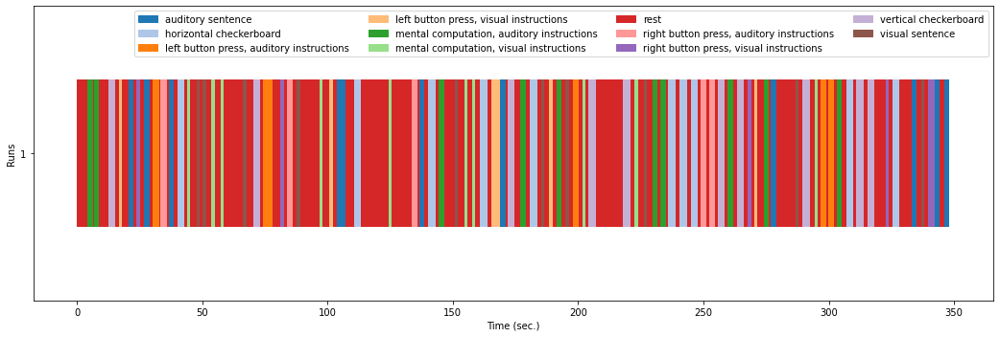

In [14]:
import matplotlib.pyplot as plt

from nilearn.plotting import plot_event

plot_event(events, figsize=(15, 5))
plt.show()

### Build the confounds Dataframe: "nuisance"

In [22]:
confounds_file=pd.read_csv(init_dir+'/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_desc-confounds_timeseries.tsv',sep= '\t')

motion6=confounds_file[["rot_x","rot_y","rot_z","trans_x",'trans_y','trans_z']]
motion24=confounds_file[["rot_x","rot_y","rot_z","trans_x","trans_y","trans_z","rot_x_derivative1","rot_y_derivative1","rot_z_derivative1",
                       "trans_x_derivative1","trans_y_derivative1","trans_z_derivative1","rot_x_power2","rot_y_power2","rot_z_power2",
                       "trans_x_power2",'trans_y_power2','trans_z_power2',"rot_x_derivative1_power2","rot_y_derivative1_power2","rot_z_derivative1_power2",
                       "trans_x_derivative1_power2","trans_y_derivative1_power2","trans_z_derivative1_power2"]]

acompcor = [] 
for i in range(0,12):
    #acompcor=acompcor.append(['w_comp_cor_' + i])
    acompcor.append("w_comp_cor_"+f"{i:02d}")
for i in range(0,12):
    #acompcor=acompcor.append(['w_comp_cor_' + i])
    acompcor.append("c_comp_cor_"+f"{i:02d}")

acompcor_reg=confounds_file[acompcor]

pd.options.mode.chained_assignment = None
motion24[np.isnan(motion24)] = 0
#display(motion24)
#display(acompcor_reg)

nuisance=result = pd.concat([motion24,acompcor_reg],axis=1)
display(nuisance)

,rot_x,rot_y,rot_z,trans_x,trans_y,trans_z,rot_x_derivative1,rot_y_derivative1,rot_z_derivative1,trans_x_derivative1,...,c_comp_cor_02,c_comp_cor_03,c_comp_cor_04,c_comp_cor_05,c_comp_cor_06,c_comp_cor_07,c_comp_cor_08,c_comp_cor_09,c_comp_cor_10,c_comp_cor_11
0,-0.001111,-0.001251,-0.001001,0.023798,-0.109870,-0.102884,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,-0.000620,-0.000777,-0.000555,0.029922,-0.102383,0.089505,0.000491,0.000473,0.000446,0.006123,...,-0.080369,0.373134,-0.627848,0.048679,-0.005647,0.020522,-0.021214,0.001944,-0.052615,0.048079
2,-0.001273,-0.000698,-0.000617,0.030637,-0.033375,0.061950,-0.000653,0.000080,-0.000062,0.000715,...,-0.098083,0.181468,-0.270589,0.115828,-0.066043,0.010183,0.001836,0.026496,0.014788,-0.101681
3,-0.001115,-0.000601,-0.000492,0.020787,-0.055846,-0.032006,0.000158,0.000097,0.000125,-0.009850,...,0.058100,0.060400,-0.112250,-0.017181,-0.049301,-0.064356,0.033343,0.061144,-0.013985,0.001092
4,-0.000218,-0.000454,-0.000560,0.023378,-0.075993,0.086691,0.000897,0.000147,-0.000067,0.002591,...,0.028754,0.037421,-0.071570,0.089036,-0.010940,-0.109551,-0.020629,-0.008872,-0.066182,0.014525
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
312,0.002655,0.001759,-0.000187,-0.005849,0.152124,0.108372,0.000019,0.000015,-0.000053,-0.002585,...,0.000264,-0.043995,0.050347,-0.061726,0.013663,-0.025774,0.019046,0.035025,0.045271,0.086242
313,0.003351,0.002059,-0.000276,0.002168,0.102031,0.134814,0.000696,0.000300,-0.000089,0.008018,...,0.053951,-0.014889,0.025023,0.090086,0.018626,-0.046103,-0.008834,-0.007975,0.049392,-0.009172
314,0.003021,0.001860,-0.000185,-0.001621,0.151631,0.147693,-0.000330,-0.000199,0.000091,-0.003789,...,-0.078309,-0.000555,0.013468,-0.053736,-0.007962,-0.091323,-0.001460,0.003019,0.029679,0.007971
315,0.002705,0.001736,-0.000162,-0.006470,0.168322,0.116396,-0.000316,-0.000124,0.000023,-0.004849,...,-0.022628,-0.062872,0.042183,0.033351,-0.036721,-0.019280,0.019476,0.042516,0.114035,0.051780


### Implement the General Linear Model for single session fMRI data

In [29]:
from nilearn.glm.first_level import FirstLevelModel,make_first_level_design_matrix
import numpy as np
import json
import os
import nibabel as nib

json_file=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_space-MNI152NLin2009cAsym_desc-preproc_bold.json"
fmri_data=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_space-MNI152NLin2009cAsym_desc-preproc_bold.nii.gz"
mask_fmri_data=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-07BodyLocalizer_space-MNI152NLin2009cAsym_desc-brain_mask.nii.gz"

img = nib.load(fmri_data)


with open(json_file, 'r') as f:
    t_r = json.load(f)['RepetitionTime']

fmri_glm = FirstLevelModel(
    t_r=t_r,
    noise_model="ar1",
    smoothing_fwhm=4,
    standardize=False,
    mask_img=mask_fmri_data,
    hrf_model="spm",
    drift_model="cosine",
    high_pass=0.01,
)


n_scans = img.shape[3]  # the acquisition comprises 128 scans
frame_times = np.arange(n_scans) * t_r  # here are the corresponding frame times

### display the reference bold image

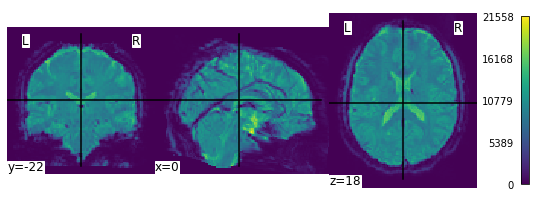

In [31]:
ref_fmri_data=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_space-MNI152NLin2009cAsym_boldref.nii.gz"

plot_img(ref_fmri_data, colorbar=True, cbar_tick_format="%i")


### Fit the data with the GLM

In [32]:
fmri_glm = fmri_glm.fit(fmri_data, events,nuisance)

### Look at the desing matrix

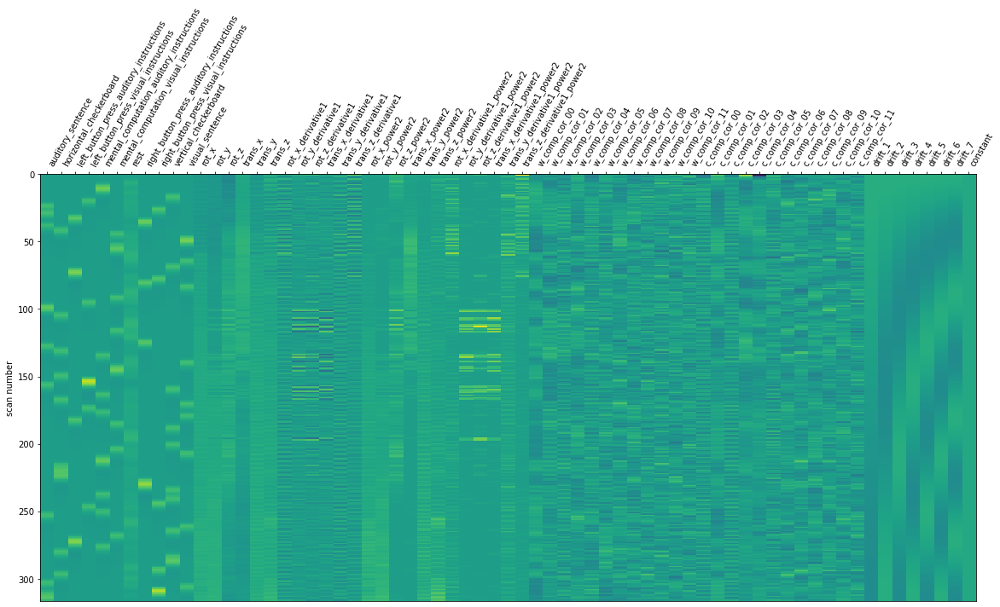

In [34]:
import matplotlib.pyplot as plt

from nilearn.plotting import plot_design_matrix

design_matrix = fmri_glm.design_matrices_[0]
plot_design_matrix(design_matrix)
#plot_design_matrix(X1)

plt.show()

In [35]:
design_matrix.shape[1]

67

In [36]:
### Save the design matrix as an image

In [37]:
import os

outdir = Path(local_dir+'/derivatives/'+"results")
if not os.path.exists(outdir):
    os.mkdir(outdir)

from os.path import join

plot_design_matrix(
    design_matrix, output_file=join(outdir, "design_matrix_new.png")
)


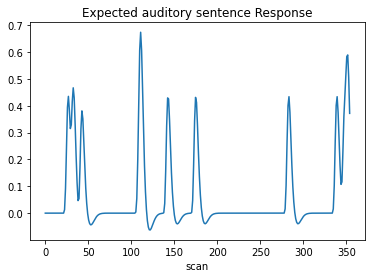

In [38]:
plt.plot(design_matrix["auditory_sentence"])
plt.xlabel("scan")
plt.title("Expected auditory sentence Response")
plt.show()

### Prepare contrasts

<AxesSubplot:label='conditions'>

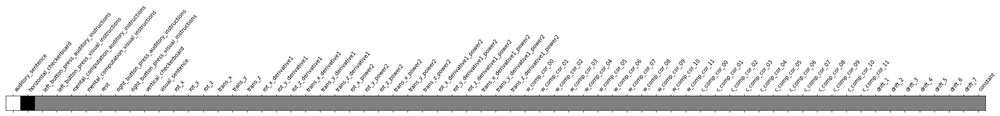

In [91]:
from nilearn.plotting import plot_contrast_matrix

conditions = {"rest": np.zeros(design_matrix.shape[1]),
              "vertical checkerboard": np.zeros(design_matrix.shape[1]),
              "horizontal checkerboard": np.zeros(design_matrix.shape[1]),
              "left button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "left button press, auditory instructions": np.zeros(design_matrix.shape[1]),
              "right button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "right button press, auditory instructions": np.zeros(design_matrix.shape[1]),
              "mental computation, visual instructions": np.zeros(design_matrix.shape[1]),
              "mental computation, auditory instructions": np.zeros(design_matrix.shape[1]),
              "left button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "visual sentence": np.zeros(design_matrix.shape[1]),
              "auditory sentence": np.zeros(design_matrix.shape[1]),
             }

conditions["auditory sentence"][0] = 1
conditions["vertical checkerboard"][1] = 1

auditory_minus_visual = conditions["auditory sentence"] - conditions["vertical checkerboard"]

plot_contrast_matrix(auditory_minus_visual  , design_matrix=design_matrix)

### Compute effect size

In [92]:
eff_map = fmri_glm.compute_contrast(
    auditory_minus_visual, output_type="effect_size"
)

### Compute z-score

In [93]:
z_map = fmri_glm.compute_contrast(auditory_minus_visual, output_type="z_score")

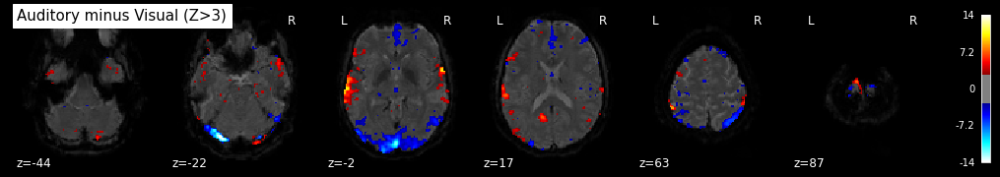

In [94]:
plot_stat_map(
    z_map,
    bg_img=ref_fmri_data,
    threshold=3.0,
    display_mode="z",
    cut_coords=6,
    black_bg=True,
    title="Auditory minus Visual (Z>3)",
)
plt.show()

Uncorrected p<0.001 threshold: 3.291


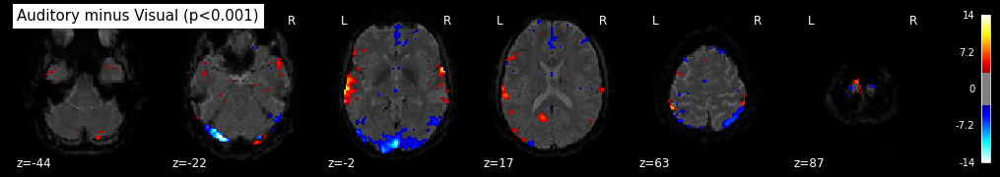

In [95]:
from nilearn.glm import threshold_stats_img

_, threshold = threshold_stats_img(z_map, alpha=0.001, height_control="fpr")
print(f"Uncorrected p<0.001 threshold: {threshold:.3f}")
plot_stat_map(
    z_map,
    bg_img=ref_fmri_data,
    threshold=threshold,
    display_mode="z",
    cut_coords=6,
    black_bg=True,
    title="Auditory minus Visual (p<0.001)",
)
plt.show()

Bonferroni-corrected, p<0.05 threshold: 5.212


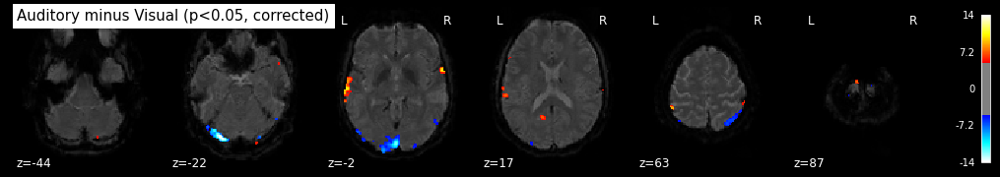

In [96]:
_, threshold = threshold_stats_img(
    z_map, alpha=0.05, height_control="bonferroni"
)
print(f"Bonferroni-corrected, p<0.05 threshold: {threshold:.3f}")
plot_stat_map(
    z_map,
    bg_img=ref_fmri_data,
    threshold=threshold,
    display_mode="z",
    cut_coords=6,
    black_bg=True,
    title="Auditory minus Visual (p<0.05, corrected)",
)
plt.show()

False Discovery rate = 0.05 threshold: 2.861


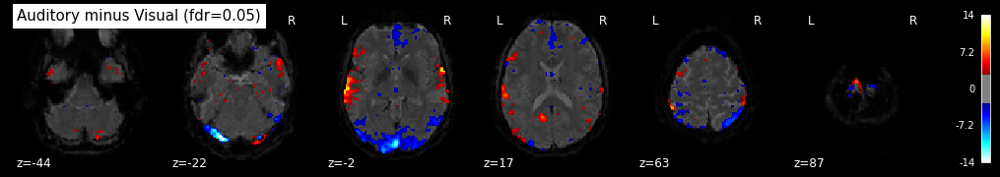

In [97]:
_, threshold = threshold_stats_img(z_map, alpha=0.05, height_control="fdr")
print(f"False Discovery rate = 0.05 threshold: {threshold:.3f}")
plot_stat_map(
    z_map,
    bg_img=ref_fmri_data,
    threshold=threshold,
    display_mode="z",
    cut_coords=6,
    black_bg=True,
    title="Auditory minus Visual (fdr=0.05)",
)
plt.show()

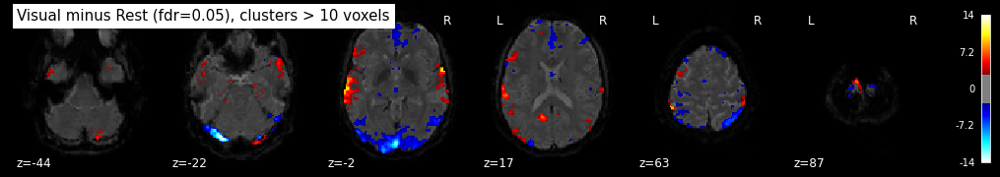

In [98]:
clean_map, threshold = threshold_stats_img(
    z_map, alpha=0.05, height_control="fdr", cluster_threshold=10
)
plot_stat_map(
    clean_map,
    bg_img=ref_fmri_data,
    threshold=threshold,
    display_mode="z",
    cut_coords=6,
    black_bg=True,
    title="Visual minus Rest (fdr=0.05), clusters > 10 voxels",
)
plt.show()

In [99]:
from nilearn.reporting import get_clusters_table

table = get_clusters_table(
    z_map, stat_threshold=threshold, cluster_threshold=20
)
table

,Cluster ID,X,Y,Z,Peak Stat,Cluster Size (mm3)
0,1,-68.5,-18.5,-4.5,11.616435,19168
1,1a,-74.5,-26.5,-6.5,9.540222,
2,1b,-66.5,-4.5,-6.5,9.438110,
3,1c,-72.5,-34.5,-6.5,9.177350,
4,2,67.5,1.5,3.5,11.221425,10216
...,...,...,...,...,...,...
82,39,-32.5,-80.5,41.5,3.842852,352
83,39a,-32.5,-78.5,33.5,3.304449,
84,39b,-32.5,-78.5,47.5,3.259351,
85,40,-64.5,-10.5,-28.5,3.657975,168


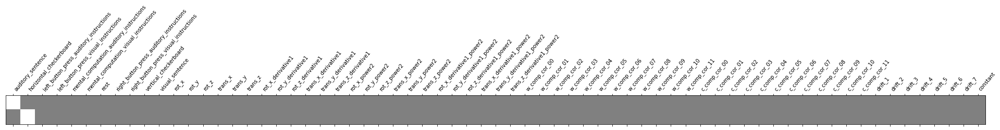

In [100]:
effects_of_interest = np.vstack((conditions["auditory sentence"], conditions["vertical checkerboard"]))
plot_contrast_matrix(effects_of_interest, design_matrix)
plt.show()

z_map = fmri_glm.compute_contrast(effects_of_interest, output_type="z_score")

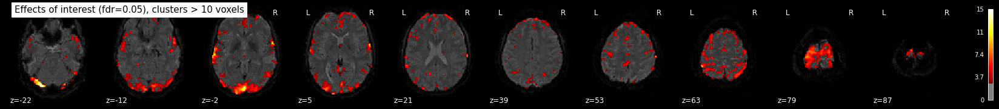

In [101]:
clean_map, threshold = threshold_stats_img(
    z_map, alpha=0.05, height_control="fdr", cluster_threshold=10
)
plot_stat_map(
    clean_map,
    bg_img=ref_fmri_data,
    threshold=threshold,
    display_mode="z",
    cut_coords=10,
    black_bg=True,
    title="Effects of interest (fdr=0.05), clusters > 10 voxels",
)
plt.show()

## Surface GLM - GIFTI format - Right Hemisphere

#### The surface was smoothed with the following command:
```
wb_command -metric-smoothing ../anat/sub-011_ses-02_hemi-R_inflated.surf.gii sub-011_ses-02_task-03ArchiLocalizer_hemi-R_space-fsnative_bold.func.gii 2 my_gii_smoothed2.func.gii
```

In [182]:
import nilearn
import hcp_utils as hcp
import nibabel as nib
import nilearn.plotting as plotting
import gzip

# if fsaverage is needed, as it is not available in the anat folder:
# either:
# fsaverage = nilearn.datasets.fetch_surf_fsaverage('fsaverage')
# or:
# fsaverage = init_dir+"/derivatives/fmriprep/sourcedata/freesurfer/fsaverage/lh.curv (for instance)


#cifti_func=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_space-fsLR_den-91k_bold.dtseries.nii"
gifti_func=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_hemi-R_space-fsnative_bold.func.gii"
gifti_func_s=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/my_gii_smoothed2.func.gii"
#cifti = nib.load(cifti_func)
gifti = nib.load(gifti_func)
gifti_s = nib.load(gifti_func_s)



### import the gifti data into nilearn with three lines of code


In [183]:
img_data = [x.data for x in gifti.darrays]
data_hemiR = np.vstack(img_data)
data_hemiR.shape

img_data_s = [x.data for x in gifti_s.darrays]
data_hemiR_s = np.vstack(img_data_s)
data_hemiR_s.shape




(317, 138835)

The gifti file is in the fsnative space, with 138 835 vetices and 317 time points

### Define background for surface plots

In [184]:
from nilearn.plotting import plot_epi, show, plot_surf, plot_surf_stat_map
from nilearn.surface import load_surf_data, load_surf_mesh
from nilearn import plotting, surface

fsnative_curv_path=init_dir+"/derivatives/fmriprep/sub-011/ses-02/anat/sub-011_ses-02_hemi-R_curv.shape.gii"
curv = surface.load_surf_data(fsnative_curv_path)


In [185]:
import json
import os


json_file=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_space-MNI152NLin2009cAsym_desc-preproc_bold.json"


with open(json_file, 'r') as f:
    t_r = json.load(f)['RepetitionTime']

n_scans = data_hemiR.shape[0]
frame_times = t_r * (np.arange(n_scans) + .5)


### Prepare nuisance regressors by reading the file `desc-confounds_timeseries.tsv` from fmriprep

In [186]:


confounds_file=pd.read_csv(init_dir+'/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_desc-confounds_timeseries.tsv',sep= '\t')

confounds_file

,global_signal,global_signal_derivative1,global_signal_derivative1_power2,global_signal_power2,csf,csf_derivative1,csf_power2,csf_derivative1_power2,white_matter,white_matter_derivative1,...,rot_x_derivative1_power2,rot_x_power2,rot_y,rot_y_derivative1,rot_y_derivative1_power2,rot_y_power2,rot_z,rot_z_derivative1,rot_z_derivative1_power2,rot_z_power2
0,10444.227705,NaN,NaN,1.090819e+08,10032.905916,NaN,1.006592e+08,NaN,6510.798522,NaN,...,NaN,1.235254e-06,-0.001251,NaN,NaN,1.564200e-06,-0.001001,NaN,NaN,1.001300e-06
1,10335.809194,-108.418511,11754.573489,1.068290e+08,9543.560941,-489.344975,9.107956e+07,239458.504664,6497.671695,-13.126828,...,2.413433e-07,3.845897e-07,-0.000777,0.000473,2.241066e-07,6.041658e-07,-0.000555,0.000446,1.987332e-07,3.078641e-07
2,10287.486240,-48.322953,2335.107828,1.058324e+08,9355.251604,-188.309337,8.752073e+07,35460.406345,6489.972295,-7.699400,...,4.260917e-07,1.620300e-06,-0.000698,0.000080,6.335682e-09,4.867630e-07,-0.000617,-0.000062,3.824062e-09,3.803115e-07
3,10267.874482,-19.611758,384.621063,1.054292e+08,9269.242338,-86.009266,8.591885e+07,7397.593829,6496.984146,7.011852,...,2.498929e-08,1.242846e-06,-0.000601,0.000097,9.411522e-09,3.608057e-07,-0.000492,0.000125,1.554261e-08,2.420876e-07
4,10242.285835,-25.588647,654.778870,1.049044e+08,9184.403421,-84.838917,8.435327e+07,7197.641813,6487.092350,-9.891796,...,8.051311e-07,4.732322e-08,-0.000454,0.000147,2.161753e-08,2.057911e-07,-0.000560,-0.000067,4.555035e-09,3.130570e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
312,10266.739260,-4.258514,18.134939,1.054059e+08,9206.935852,16.081254,8.476767e+07,258.606744,6509.750962,-5.941357,...,3.659569e-10,7.049131e-06,0.001759,0.000015,2.377764e-10,3.094961e-06,-0.000187,-0.000053,2.824285e-09,3.492974e-08
313,10261.138953,-5.600307,31.363444,1.052910e+08,9171.920884,-35.014968,8.412413e+07,1226.047967,6511.533939,1.782977,...,4.847223e-07,1.123081e-05,0.002059,0.000300,8.972421e-08,4.238616e-06,-0.000276,-0.000089,7.970561e-09,7.627153e-08
314,10265.087611,3.948659,15.591906,1.053720e+08,9176.049893,4.129009,8.419989e+07,17.048717,6506.973680,-4.560259,...,1.087944e-07,9.128858e-06,0.001860,-0.000199,3.951746e-08,3.459600e-06,-0.000185,0.000091,8.321088e-09,3.420761e-08
315,10266.047275,0.959663,0.920953,1.053917e+08,9198.898076,22.848183,8.461973e+07,522.039449,6508.455287,1.481607,...,1.001153e-07,7.316971e-06,0.001736,-0.000124,1.527943e-08,3.015050e-06,-0.000162,0.000023,5.397258e-10,2.615368e-08


In [187]:
confounds_file=pd.read_csv(init_dir+'/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_desc-confounds_timeseries.tsv',sep= '\t')

motion6=confounds_file[["rot_x","rot_y","rot_z","trans_x",'trans_y','trans_z']]
motion24=confounds_file[["rot_x","rot_y","rot_z","trans_x","trans_y","trans_z","rot_x_derivative1","rot_y_derivative1","rot_z_derivative1",
                       "trans_x_derivative1","trans_y_derivative1","trans_z_derivative1","rot_x_power2","rot_y_power2","rot_z_power2",
                       "trans_x_power2",'trans_y_power2','trans_z_power2',"rot_x_derivative1_power2","rot_y_derivative1_power2","rot_z_derivative1_power2",
                       "trans_x_derivative1_power2","trans_y_derivative1_power2","trans_z_derivative1_power2"]]

acompcor = [] 
for i in range(0,12):
    #acompcor=acompcor.append(['w_comp_cor_' + i])
    acompcor.append("w_comp_cor_"+f"{i:02d}")
for i in range(0,12):
    #acompcor=acompcor.append(['w_comp_cor_' + i])
    acompcor.append("c_comp_cor_"+f"{i:02d}")

acompcor_reg=confounds_file[acompcor]

pd.options.mode.chained_assignment = None
motion24[np.isnan(motion24)] = 0
#display(motion24)
#display(acompcor_reg)

nuisance=result = pd.concat([motion24,acompcor_reg],axis=1)
display(nuisance)

,rot_x,rot_y,rot_z,trans_x,trans_y,trans_z,rot_x_derivative1,rot_y_derivative1,rot_z_derivative1,trans_x_derivative1,...,c_comp_cor_02,c_comp_cor_03,c_comp_cor_04,c_comp_cor_05,c_comp_cor_06,c_comp_cor_07,c_comp_cor_08,c_comp_cor_09,c_comp_cor_10,c_comp_cor_11
0,-0.001111,-0.001251,-0.001001,0.023798,-0.109870,-0.102884,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,-0.000620,-0.000777,-0.000555,0.029922,-0.102383,0.089505,0.000491,0.000473,0.000446,0.006123,...,-0.080369,0.373134,-0.627848,0.048679,-0.005647,0.020522,-0.021214,0.001944,-0.052615,0.048079
2,-0.001273,-0.000698,-0.000617,0.030637,-0.033375,0.061950,-0.000653,0.000080,-0.000062,0.000715,...,-0.098083,0.181468,-0.270589,0.115828,-0.066043,0.010183,0.001836,0.026496,0.014788,-0.101681
3,-0.001115,-0.000601,-0.000492,0.020787,-0.055846,-0.032006,0.000158,0.000097,0.000125,-0.009850,...,0.058100,0.060400,-0.112250,-0.017181,-0.049301,-0.064356,0.033343,0.061144,-0.013985,0.001092
4,-0.000218,-0.000454,-0.000560,0.023378,-0.075993,0.086691,0.000897,0.000147,-0.000067,0.002591,...,0.028754,0.037421,-0.071570,0.089036,-0.010940,-0.109551,-0.020629,-0.008872,-0.066182,0.014525
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
312,0.002655,0.001759,-0.000187,-0.005849,0.152124,0.108372,0.000019,0.000015,-0.000053,-0.002585,...,0.000264,-0.043995,0.050347,-0.061726,0.013663,-0.025774,0.019046,0.035025,0.045271,0.086242
313,0.003351,0.002059,-0.000276,0.002168,0.102031,0.134814,0.000696,0.000300,-0.000089,0.008018,...,0.053951,-0.014889,0.025023,0.090086,0.018626,-0.046103,-0.008834,-0.007975,0.049392,-0.009172
314,0.003021,0.001860,-0.000185,-0.001621,0.151631,0.147693,-0.000330,-0.000199,0.000091,-0.003789,...,-0.078309,-0.000555,0.013468,-0.053736,-0.007962,-0.091323,-0.001460,0.003019,0.029679,0.007971
315,0.002705,0.001736,-0.000162,-0.006470,0.168322,0.116396,-0.000316,-0.000124,0.000023,-0.004849,...,-0.022628,-0.062872,0.042183,0.033351,-0.036721,-0.019280,0.019476,0.042516,0.114035,0.051780


### Prepare the design matrix

In [188]:
from nilearn.glm.first_level import make_first_level_design_matrix
import json


json_file=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_space-MNI152NLin2009cAsym_desc-preproc_bold.json"


with open(json_file, 'r') as f:
    t_r = json.load(f)['RepetitionTime']

n_scans = data_hemiR.shape[0]
frame_times = t_r * (np.arange(n_scans) + .5)


design_matrix = make_first_level_design_matrix(frame_times,
                                               events=events,
                                               hrf_model='spm',
                                               add_regs=nuisance
                                               )

design_matrix.values.shape

(317, 67)

### Plot the design matrix

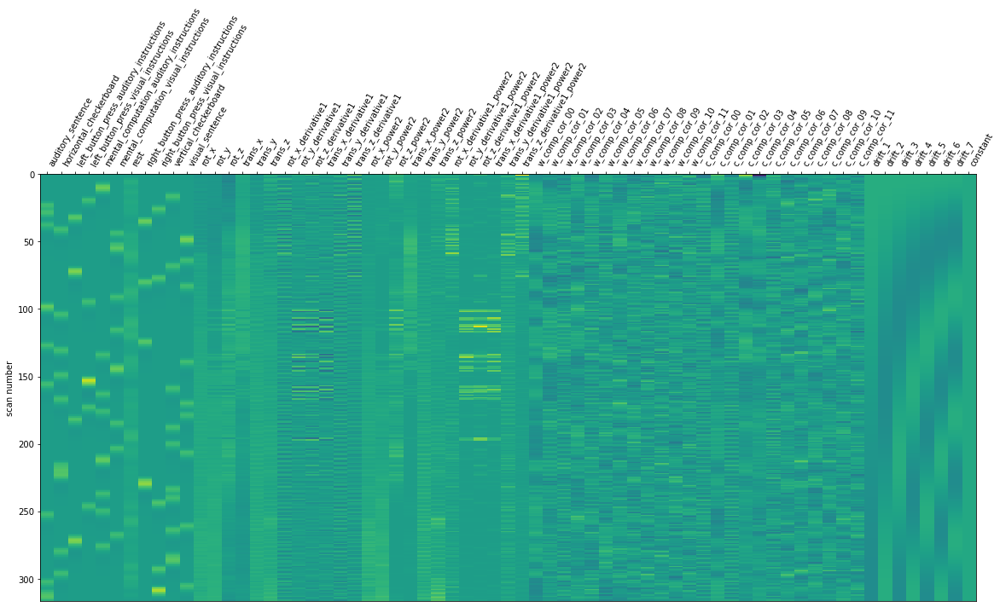

In [189]:
plot_design_matrix(design_matrix)

plt.show()

### Fit the GLM

In [78]:
from nilearn.glm.first_level import run_glm

labels, estimates = run_glm(data_hemiR, design_matrix.values)
labels_s, estimates_s = run_glm(data_hemiR_s, design_matrix.values)

### Prepare the contrasts: exemple with "auditory Sentence" - "horizontal checkerboard"
Watchout for nilearn reordering of conditions columns based on alphabetical order !!!

<AxesSubplot:label='conditions'>

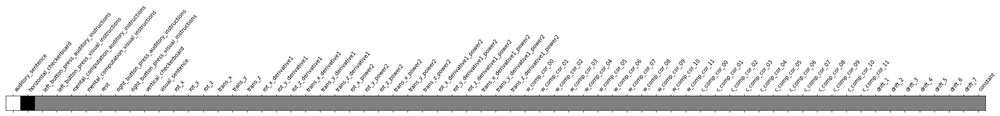

In [191]:
from nilearn.plotting import plot_contrast_matrix

conditions = {"rest": np.zeros(design_matrix.shape[1]),
              "vertical checkerboard": np.zeros(design_matrix.shape[1]),
              "horizontal checkerboard": np.zeros(design_matrix.shape[1]),
              "left button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "left button press, auditory instructions": np.zeros(design_matrix.shape[1]),
              "right button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "right button press, auditory instructions": np.zeros(design_matrix.shape[1]),
              "mental computation, visual instructions": np.zeros(design_matrix.shape[1]),
              "mental computation, auditory instructions": np.zeros(design_matrix.shape[1]),
              "left button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "visual sentence": np.zeros(design_matrix.shape[1]),
              "auditory sentence": np.zeros(design_matrix.shape[1]),
             }

conditions["auditory sentence"][0] = 1
conditions["vertical checkerboard"][1] = 1

auditory_minus_visual = conditions["auditory sentence"] - conditions["vertical checkerboard"]

plot_contrast_matrix(auditory_minus_visual  , design_matrix=design_matrix)

### Plot the activation for the contrast "Auditory Sentence" - "horizontal checker board" - non smoothed data

In [83]:
from nilearn import plotting
from nilearn.glm.contrasts import compute_contrast

contrast = compute_contrast(labels, estimates, auditory_minus_visual,
                                contrast_type='t')
contrast_id="Audio_minus_Visual"
# we present the Z-transform of the t map
z_score = contrast.z_score()
# we plot it on the surface, on the inflated fsaverage mesh,
# together with a suitable background to give an impression
# of the cortex folding.

z_score = contrast.z_score()


surface_path=init_dir+"/derivatives/fmriprep/sub-011/ses-02/anat/sub-011_ses-02_hemi-R_inflated.surf.gii"

#plotting.plot_surf_stat_map(
#    surface_path, z_score, hemi='right',
#    title=contrast_id, colorbar=True,
#    threshold=3., bg_map=fsnative_curv_path)

#fsaverage_path=init_dir+"/derivatives/fmriprep/sourcedata/freesurfer/fsaverage/surf/lh.inflated"
plotting.view_surf(surface_path, z_score, threshold=3., bg_map=fsnative_curv_path)

### Plot the activation for the contrast "Auditory Sentence" - "horizontal checker board" -  smoothed data

In [84]:
from nilearn import plotting
from nilearn.glm.contrasts import compute_contrast

contrast_s = compute_contrast(labels_s, estimates_s, auditory_minus_visual,
                                contrast_type='t')
contrast_id="Audio_minus_Visual"
# we present the Z-transform of the t map
z_score_s = contrast_s.z_score()
# we plot it on the surface, on the inflated fsaverage mesh,
# together with a suitable background to give an impression
# of the cortex folding.

surface_path=init_dir+"/derivatives/fmriprep/sub-011/ses-02/anat/sub-011_ses-02_hemi-R_inflated.surf.gii"

#plotting.plot_surf_stat_map(
#    surface_path, z_score_s, hemi='right',
#    title=contrast_id, colorbar=True,
#    threshold=3., bg_map=fsnative_curv_path)

#fsaverage_path=init_dir+"/derivatives/fmriprep/sourcedata/freesurfer/fsaverage/surf/lh.inflated"
plotting.view_surf(surface_path, z_score_s, threshold=3., bg_map=fsnative_curv_path)

## Surface GLM - CIFTI file
#### The CIFTI file was smoothed with the following command:
```
wb_command -cifti-smoothing sub-011_ses-02_task-03ArchiLocalizer_space-fsLR_den-91k_bold.dtseries.nii \
 4 4 COLUMN \
 sub-011_ses-02_task-03ArchiLocalizer_space-fsLR_den-91k_bold_s4.dtseries.nii /
 -fix-zeros-volume \
 -right-surface /Users/jsein/neuromaps-data/atlases/fsLR/tpl-fsLR_den-32k_hemi-R_inflated.surf.gii \
 -left-surface /Users/jsein/neuromaps-data/atlases/fsLR/tpl-fsLR_den-32k_hemi-L_inflated.surf.gii
```


In [192]:
import nilearn
import hcp_utils as hcp
import nibabel as nib
import nilearn.plotting as plotting
from nilearn.glm.first_level import run_glm
import numpy as np

cifti_func=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_space-fsLR_den-91k_bold.dtseries.nii"
cifti = nib.load(cifti_func)

right_surf="/Users/jsein/.cache/templateflow/tpl-fsLR/tpl-fsLR_den-32k_hemi-R_inflated.surf.gii"
left_surf="/Users/jsein/.cache/templateflow/tpl-fsLR/tpl-fsLR_den-32k_hemi-L_inflated.surf.gii"

r_surf=nib.load(right_surf)
l_surf=nib.load(left_surf)


img_data = [x.data for x in r_surf.darrays]
data_hemiR = np.vstack(img_data)
data_hemiR.shape


(97472, 3)

The right cortical surface on which the cifti file is based on has 97 472 triangles and tree times as much vertices ???

In [194]:
img_data = [x.data for x in l_surf.darrays]
data_hemiL = np.vstack(img_data)
data_hemiL.shape

(97472, 3)

Same thing for left cortical surface

In [123]:
cifti.shape

(317, 91282)

The cifti file has 317 times points, and 91 282 elements. Let's see into more details:

In [201]:
!wb_command -file-information /Users/jsein/Documents/Centre_IRMf/DATA/BIDS/BRAINT/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_space-fsLR_den-91k_bold.dtseries.nii -no-map-info

Name:                           /Users/jsein/Documents/Centre_IRMf/DATA/BIDS/BRAINT/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_space-fsLR_den-91k_bold.dtseries.nii
Type:                           CIFTI - Dense Data Series
Structure:                      CortexLeft CortexRight 
Data Size:                      115.75 Megabytes
Maps to Surface:                true
Maps to Volume:                 true
Maps with LabelTable:           false
Maps with Palette:              true
All Map Palettes Equal:         true
Map Interval Units:             NIFTI_UNITS_SEC
Map Interval Start:             0.000
Map Interval Step:              1.120
Number of Rows:                 91282
Number of Columns:              317
Volume Dim[0]:                  91
Volume Dim[1]:                  109
Volume Dim[2]:                  91
Palette Type:                   File (One for all maps)
CIFTI Dim[0]:                   317
CIFTI Dim[1]:                   91282
ALONG_ROW map type

### The CIFTI file can be splitted in 2 GIFTI files (2 hemisphere surfaces) + 1 NIFTI file (subcortical volume in MNI152NLin6 space) with the following command:

```
 wb_command -cifti-separate-all sub-011_ses-02_task-03ArchiLocalizer_space-fsLR_den-91k_bold.dtseries.nii \
  -volume cifti_volume.nii.gz \
  -left cifti_left.func.gii \
  -right cifti_right.func.gii
```


In [149]:
new_right_surf=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/cifti_right.func.gii"
new_left_surf=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/cifti_left.func.gii"

new_right_surf_s=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/cifti_right_s4.func.gii"

subcortical_path=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/cifti_volume.nii.gz"

new_r_surf=nib.load(new_right_surf)
new_r_surf_s=nib.load(new_right_surf_s)

new_l_surf=nib.load(new_left_surf)
subcortical_img = nib.load(subcortical_path)

img_data = [x.data for x in new_l_surf.darrays]
data_hemiLnew = np.vstack(img_data)
data_hemiLnew.shape


(317, 32492)

This is the size of the extracted gifti file for the right cortical surface with 32k vertices

In [143]:
img_data_s = [x.data for x in new_r_surf_s.darrays]
data_hemiRnew_s = np.vstack(img_data_s)
data_hemiRnew_s.shape

(317, 32492)

same thing for the left cortical surface 

In [150]:
subcortical_img.shape

(91, 109, 91, 317)

This is the size of the subcortical fMRI 4D volume based on the `tpl-MNI152NLin6Asym` space.

## Run GLM on extracted GIFTI surface from CIFTI file
### Prepare the design matrix


In [144]:
t_r = 1.12
n_scans = cifti.shape[0]
frame_times = t_r * (np.arange(n_scans) + .5)

design_matrix = make_first_level_design_matrix(frame_times,
                                               events=events,
                                               hrf_model='spm',
                                               add_regs=nuisance
                                               )

#labels, estimates = run_glm(texture.T, design_matrix.values)
labels, estimates = run_glm(data_hemiRnew, design_matrix.values)

labels_s, estimates_s = run_glm(data_hemiRnew_s, design_matrix.values)

Prepare the contrast: "auditory sentence" - "vertical checkerboard"

<AxesSubplot:label='conditions'>

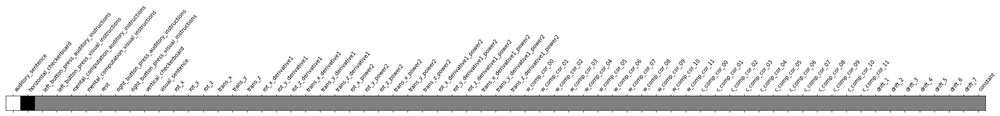

In [133]:
from nilearn.plotting import plot_contrast_matrix

conditions = {"rest": np.zeros(design_matrix.shape[1]),
              "vertical checkerboard": np.zeros(design_matrix.shape[1]),
              "horizontal checkerboard": np.zeros(design_matrix.shape[1]),
              "left button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "left button press, auditory instructions": np.zeros(design_matrix.shape[1]),
              "right button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "right button press, auditory instructions": np.zeros(design_matrix.shape[1]),
              "mental computation, visual instructions": np.zeros(design_matrix.shape[1]),
              "mental computation, auditory instructions": np.zeros(design_matrix.shape[1]),
              "left button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "visual sentence": np.zeros(design_matrix.shape[1]),
              "auditory sentence": np.zeros(design_matrix.shape[1]),
             }

conditions["auditory sentence"][0] = 1
conditions["horizontal checkerboard"][1] = 1

auditory_minus_visual = conditions["auditory sentence"] - conditions["horizontal checkerboard"]

plot_contrast_matrix(auditory_minus_visual  , design_matrix=design_matrix)

### Plot design matrix

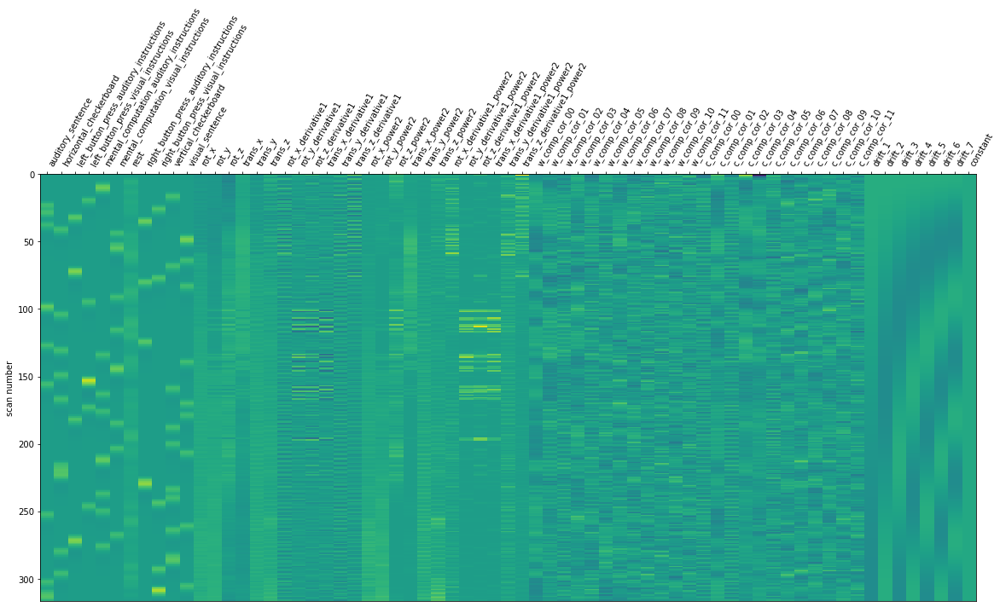

In [134]:
plot_design_matrix(design_matrix)
#plot_design_matrix(X1)

plt.show()

### Plot the activation map for this contrast on the right cortical surface from the HCP template `tpl-fsLR_den-32k_hemi-R_inflated.surf.gii` - non-smoothed cifti file

In [141]:
from nilearn import plotting
from nilearn.glm.contrasts import compute_contrast

contrast = compute_contrast(labels, estimates, auditory_minus_visual,
                                contrast_type='t')
contrast_id="Audio_minus_Visual"
# we present the Z-transform of the t map
z_score = contrast.z_score()
# we plot it on the surface, on the inflated fsaverage mesh,
# together with a suitable background to give an impression
# of the cortex folding.

z_score = contrast.z_score()

right_surf="/Users/jsein/.cache/templateflow/tpl-fsLR/tpl-fsLR_den-32k_hemi-R_inflated.surf.gii"
left_surf="/Users/jsein/.cache/templateflow/tpl-fsLR/tpl-fsLR_den-32k_hemi-L_inflated.surf.gii"

fsLR_curv_path="/Users/jsein/.cache/templateflow/tpl-fsLR/tpl-fsLR_hemi-L_den-32k_desc-vaavg_midthickness.shape.gii"
#curv = surface.load_surf_data(fsnative_curv_path)


#plotting.plot_surf_stat_map(
#    surface_path, z_score, hemi='right',
#    title=contrast_id, colorbar=True,
#    threshold=3., bg_map=fsnative_curv_path)

#fsaverage_path=init_dir+"/derivatives/fmriprep/sourcedata/freesurfer/fsaverage/surf/lh.inflated"
plotting.view_surf(right_surf, z_score, threshold=3., bg_map=fsLR_curv_path)

### Plot the activation map for this contrast on the right cortical surface from the HCP template `tpl-fsLR_den-32k_hemi-R_inflated.surf.gii` - smoothed cifti file

In [145]:
from nilearn import plotting
from nilearn.glm.contrasts import compute_contrast

contrast = compute_contrast(labels_s, estimates_s, auditory_minus_visual,
                                contrast_type='t')
contrast_id="Audio_minus_Visual"
# we present the Z-transform of the t map
z_score = contrast.z_score()
# we plot it on the surface, on the inflated fsaverage mesh,
# together with a suitable background to give an impression
# of the cortex folding.

z_score = contrast.z_score()

right_surf="/Users/jsein/.cache/templateflow/tpl-fsLR/tpl-fsLR_den-32k_hemi-R_inflated.surf.gii"
left_surf="/Users/jsein/.cache/templateflow/tpl-fsLR/tpl-fsLR_den-32k_hemi-L_inflated.surf.gii"

fsLR_curv_path="/Users/jsein/.cache/templateflow/tpl-fsLR/tpl-fsLR_hemi-L_den-32k_desc-vaavg_midthickness.shape.gii"
#curv = surface.load_surf_data(fsnative_curv_path)


#plotting.plot_surf_stat_map(
#    surface_path, z_score, hemi='right',
#    title=contrast_id, colorbar=True,
#    threshold=3., bg_map=fsnative_curv_path)

#fsaverage_path=init_dir+"/derivatives/fmriprep/sourcedata/freesurfer/fsaverage/surf/lh.inflated"
plotting.view_surf(right_surf, z_score, threshold=3., bg_map=fsLR_curv_path)

## Run GLM on extracted NIFTI subcortical volume from CIFTI file

### plot template image of MNI152NLin6Asym

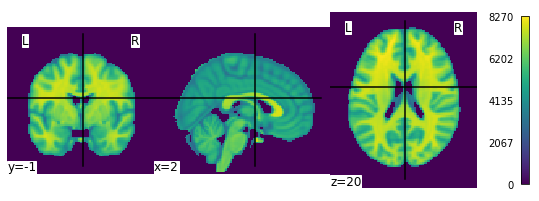

In [153]:
ref_fmri_data="/Users/jsein/.cache/templateflow/tpl-MNI152NLin6Asym/tpl-MNI152NLin6Asym_res-02_desc-brain_T1w.nii.gz"

plot_img(ref_fmri_data, colorbar=True, cbar_tick_format="%i")

### Prepare the model, fit the GLM and look at the design matrix

In [154]:
from nilearn.glm.first_level import FirstLevelModel,make_first_level_design_matrix
import numpy as np
import json
import os
import nibabel as nib

json_file=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/sub-011_ses-02_task-03ArchiLocalizer_space-MNI152NLin2009cAsym_desc-preproc_bold.json"

subcortical_path=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/cifti_volume.nii.gz"
subcortical = nib.load(subcortical_path)


with open(json_file, 'r') as f:
    t_r = json.load(f)['RepetitionTime']

fmri_glm = FirstLevelModel(
    t_r=t_r,
    noise_model="ar1",
    smoothing_fwhm=4,
    standardize=False,
    mask_img=mask_fmri_data,
    hrf_model="spm",
    drift_model="cosine",
    high_pass=0.01,
)


n_scans = subcortical.shape[3]  # the acquisition comprises 128 scans
frame_times = np.arange(n_scans) * t_r  # here are the corresponding frame times

In [155]:
fmri_glm = fmri_glm.fit(subcortical_path, events,nuisance)

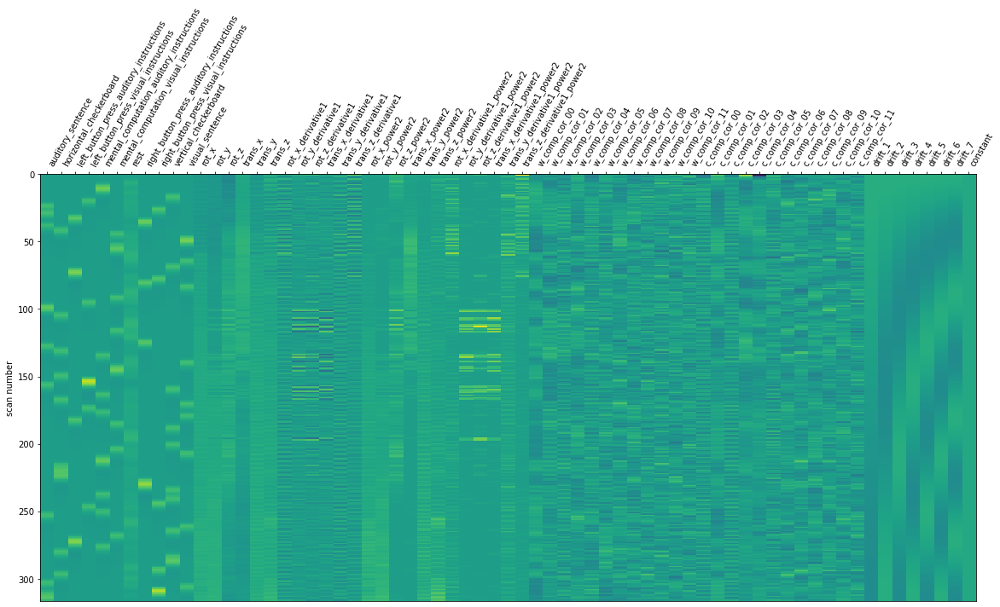

In [156]:
import matplotlib.pyplot as plt

from nilearn.plotting import plot_design_matrix

design_matrix = fmri_glm.design_matrices_[0]
plot_design_matrix(design_matrix)
#plot_design_matrix(X1)

plt.show()

### Look at the same contrast as before, i.e. "auditory sentence" - "horizontal ceckerboard"

<AxesSubplot:label='conditions'>

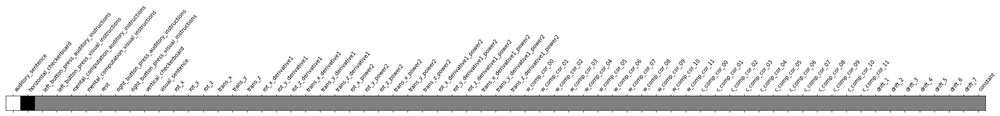

In [157]:
from nilearn.plotting import plot_contrast_matrix

conditions = {"rest": np.zeros(design_matrix.shape[1]),
              "vertical checkerboard": np.zeros(design_matrix.shape[1]),
              "horizontal checkerboard": np.zeros(design_matrix.shape[1]),
              "left button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "left button press, auditory instructions": np.zeros(design_matrix.shape[1]),
              "right button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "right button press, auditory instructions": np.zeros(design_matrix.shape[1]),
              "mental computation, visual instructions": np.zeros(design_matrix.shape[1]),
              "mental computation, auditory instructions": np.zeros(design_matrix.shape[1]),
              "left button press, visual instructions": np.zeros(design_matrix.shape[1]),
              "visual sentence": np.zeros(design_matrix.shape[1]),
              "auditory sentence": np.zeros(design_matrix.shape[1]),
             }

conditions["auditory sentence"][0] = 1
conditions["vertical checkerboard"][1] = 1

auditory_minus_visual = conditions["auditory sentence"] - conditions["vertical checkerboard"]

plot_contrast_matrix(auditory_minus_visual  , design_matrix=design_matrix)

### Compute the z map

In [158]:
z_map = fmri_glm.compute_contrast(auditory_minus_visual, output_type="z_score")

### Plot the activations for non-smoothed subcortical voxels

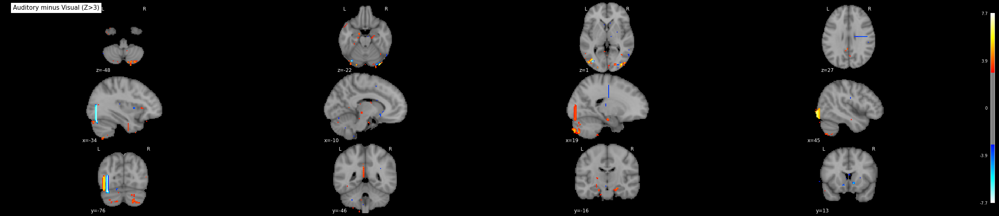

In [169]:
plot_stat_map(
    z_map,
    bg_img=ref_fmri_data,
    threshold=3.0,
    display_mode="mosaic",
    cut_coords=4,
    black_bg=True,
    title="Auditory minus Visual (Z>3)",
)
plt.show()

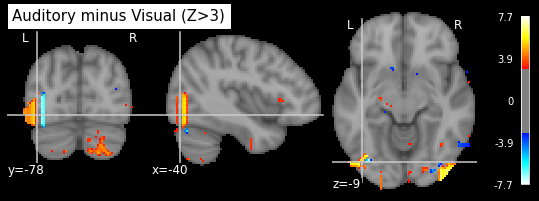

In [178]:
plotting.plot_stat_map(z_map,
    bg_img=ref_fmri_data,
    threshold=3.0,
    black_bg=True,
    title="Auditory minus Visual (Z>3)")

## Visualize the subcortical voxels from he CIFTI file

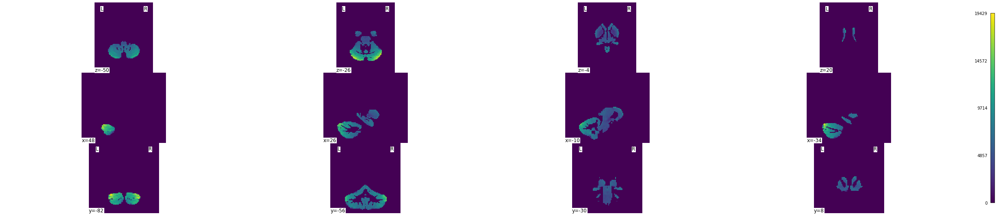

In [171]:
from nilearn.plotting import plot_anat, plot_img, plot_stat_map
from nilearn.image import concat_imgs, mean_img

subcortical_path_s=init_dir+"/derivatives/fmriprep/sub-011/ses-02/func/cifti_volume_s4.nii.gz"

mean_img = mean_img(subcortical_path)

plot_img(mean_img, colorbar=True, cbar_tick_format="%i",display_mode="mosaic",cut_coords=4)

/Users/jsein/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:755: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



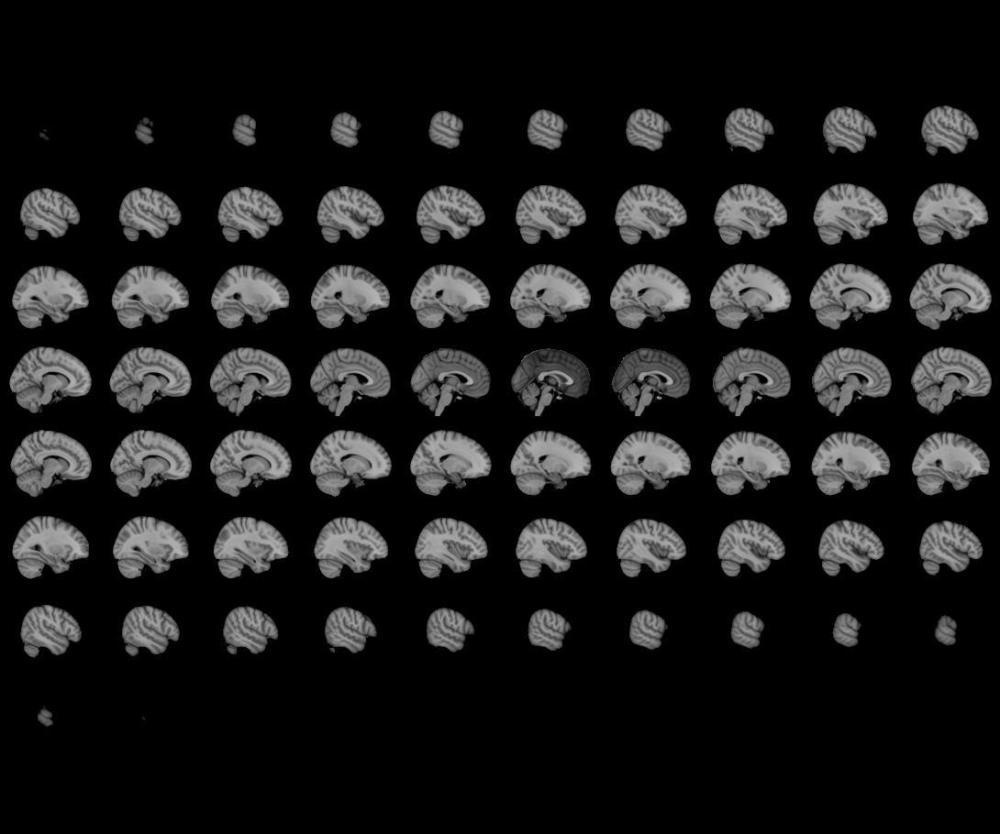
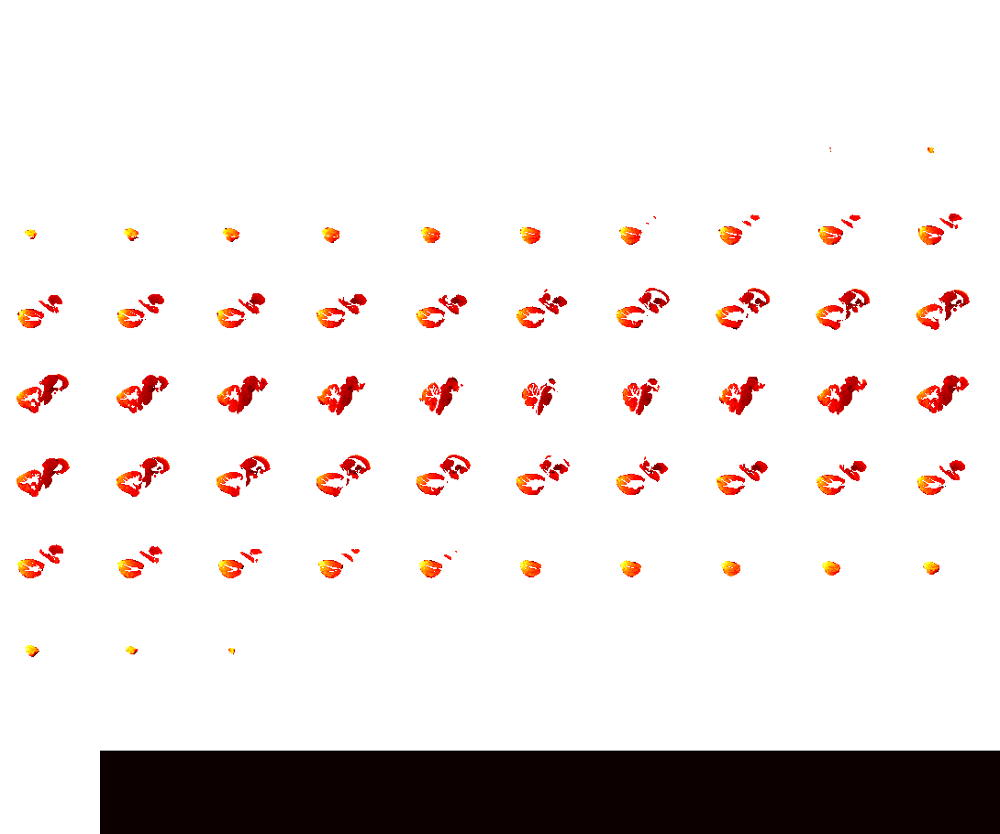

In [174]:
plotting.view_img(mean_img,bg_img=ref_fmri_data)

### Plot the activations for smoothed subcortical voxels


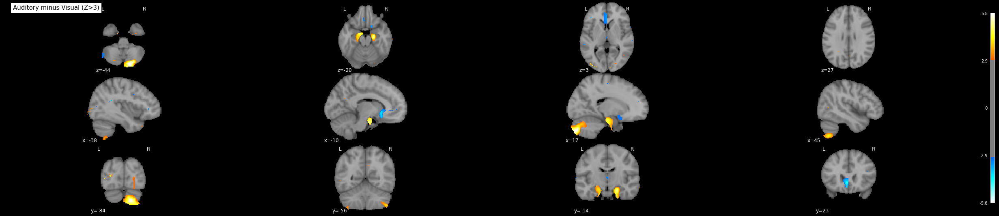

In [168]:


fmri_glm_s = fmri_glm.fit(subcortical_path_s, events,nuisance)

design_matrix_s = fmri_glm_s.design_matrices_[0]

z_map_s = fmri_glm_s.compute_contrast(auditory_minus_visual, output_type="z_score")

plot_stat_map(
    z_map_s,
    bg_img=ref_fmri_data,
    threshold=3.0,
    display_mode="mosaic",
    cut_coords=4,
    black_bg=True,
    title="Auditory minus Visual (Z>3)",
)
plt.show()

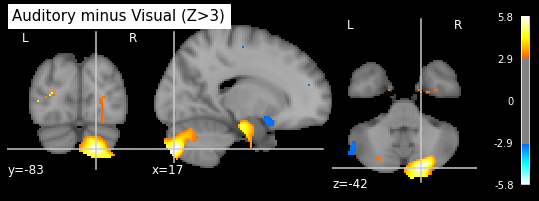

In [177]:
plotting.plot_stat_map(z_map_s,
    bg_img=ref_fmri_data,
    threshold=3.0,
    black_bg=True,
    title="Auditory minus Visual (Z>3)")